# Loading libraries

In [1]:
library(opera)

# Loading datasets

In [3]:
# French data
data_train <- read.csv("data/train.csv")
data_test1 <- read.csv("data/test1.csv")
data_test2 <- read.csv("data/test2.csv")

# GAM finetuned
gamf1 <- read.csv("data/experts/ft_te1.csv")
gamf2 <- read.csv("data/experts/ft_te2.csv")

# GBM
gbm1 <- read.csv("data/experts/gbm1_forecast.csv")
gbm2 <- read.csv("data/experts/gbm2_forecast.csv")

In [31]:
gamf1 <- gamf1$ft_te1
gamf2 <- gamf2$ft_te2
gbm1 <- gbm1$x
gbm2 <- gbm2$x

In [32]:
# Compute MAPE
mape <- function(x, y) {
  mean(abs(x - y)/x)*100
}

print(paste("The MAPE on the test set 1 is", round(mape(data_test1$Consommation, gamf1), 2), "%", sep = " "))
print(paste("The MAPE on the test set 2 is", round(mape(data_test2$Consommation, gamf2), 2), "%", sep = " "))


[1] "The MAPE on the test set 1 is 6.12 %"
[1] "The MAPE on the test set 2 is 4.83 %"


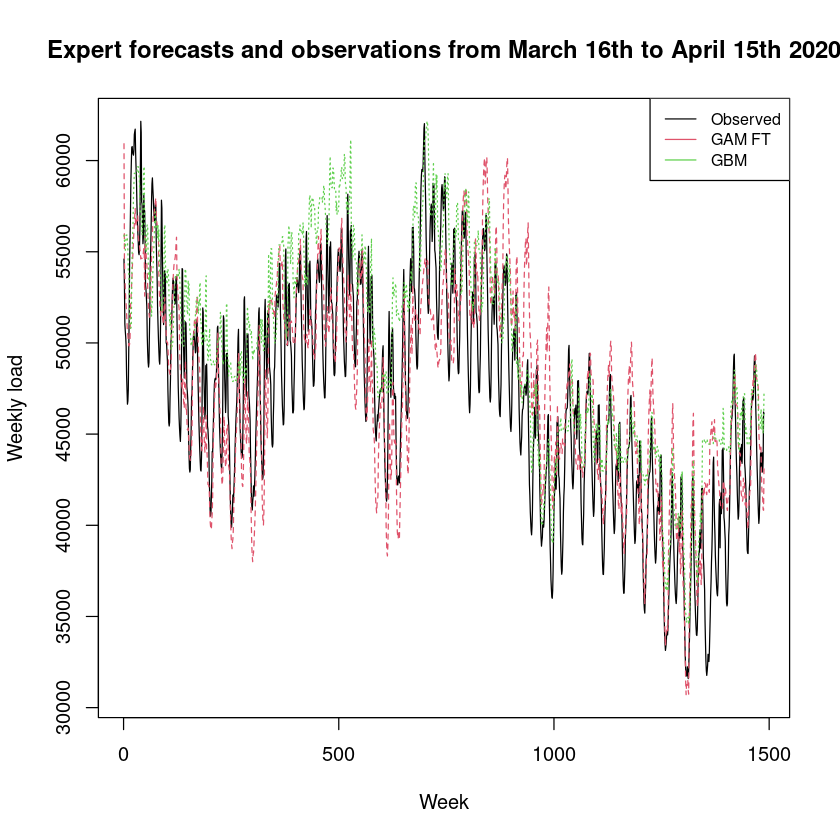

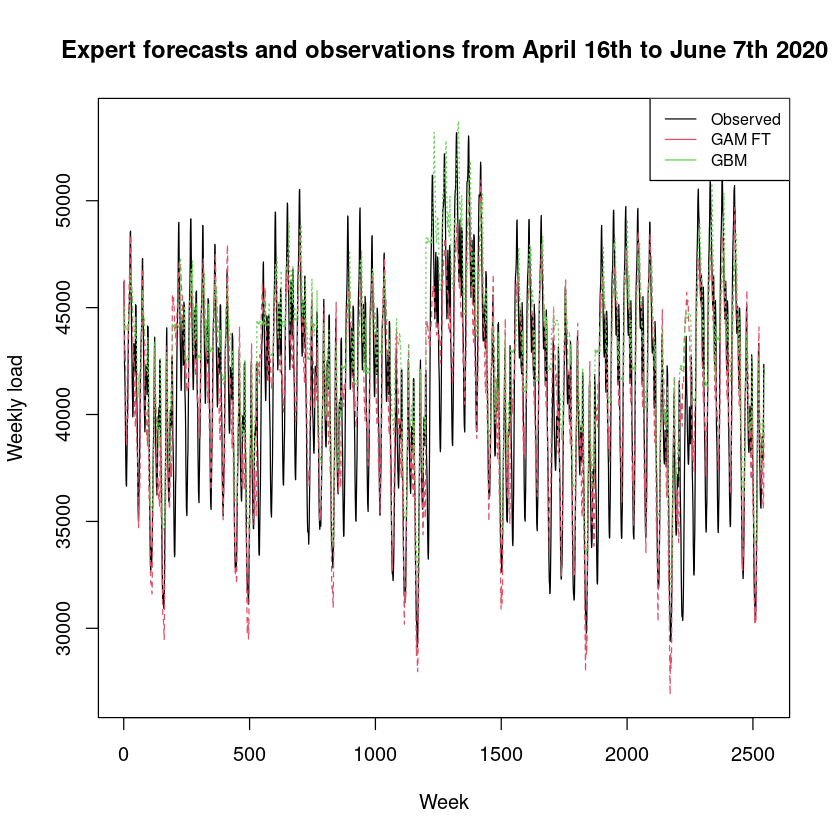

In [33]:
Y1 <- data_test1$Consommation
X1 <- cbind(gamf1, gbm1)
matplot(cbind(Y1, X1), type = "l", col = 1:6, ylab = "Weekly load", 
        xlab = "Week", main = "Expert forecasts and observations from March 16th to April 15th 2020")
legend("topright", legend = c("Observed", "GAM FT", "GBM"), col = 1:3, lty = 1, cex = 0.8)

Y2 <- data_test2$Consommation
X2 <- cbind(gamf2, gbm2)
matplot(cbind(Y2, X2), type = "l", col = 1:6, ylab = "Weekly load", 
        xlab = "Week", main = "Expert forecasts and observations from April 16th to June 7th 2020")
legend("topright", legend = c("Observed", "GAM FT", "GBM"), col = 1:3, lty = 1, cex = 0.8)

In [34]:
oracle.convex <- oracle(Y = Y1, experts = X1, loss.type = "square", model = "convex")
print(oracle.convex)
plot(oracle.convex)

Call:
oracle.default(Y = Y1, experts = X1, model = "convex", loss.type = "square")

Coefficients:
 gamf1  gbm1
 0.688 0.312

                      rmse   mape
Best expert oracle:   3540 0.0612
Uniform combination:  3380 0.0586
Best convex oracle:   3280 0.0560


HTML widgets cannot be represented in plain text (need html)

In [35]:
oracle.convex <- oracle(Y = Y2, experts = X2, loss.type = "square", model = "convex")
print(oracle.convex)
plot(oracle.convex)

Call:
oracle.default(Y = Y2, experts = X2, model = "convex", loss.type = "square")

Coefficients:
 gamf2   gbm2
 0.903 0.0975

                      rmse   mape
Best expert oracle:   2540 0.0483
Uniform combination:  2740 0.0519
Best convex oracle:   2530 0.0478


HTML widgets cannot be represented in plain text (need html)

In [36]:
MLpol0 <- mixture(model = "MLpol", loss.type = "square")

MLpol1 <- MLpol0
for (i in 1:length(Y1)) {
  MLpol1 <- predict(MLpol1, newexperts = X1[i, ], newY = Y1[i])
}

MLpol2 <- MLpol0
for (i in 1:length(Y2)) {
  MLpol2 <- predict(MLpol2, newexperts = X2[i, ], newY = Y2[i])
}

summary(MLpol1)
summary(MLpol2)
plot(MLpol1)
plot(MLpol2)

Aggregation rule: MLpol 
Loss function:  squareloss 
Gradient trick:  TRUE 
Coefficients: 
 gamf1  gbm1
 0.803 0.197

Number of experts:  2
Number of observations:  1488
Dimension of the data:  1 

        rmse   mape
MLpol   3100 0.0524
Uniform 3380 0.0586

Aggregation rule: MLpol 
Loss function:  squareloss 
Gradient trick:  TRUE 
Coefficients: 
 gamf2   gbm2
 0.986 0.0138

Number of experts:  2
Number of observations:  2544
Dimension of the data:  1 

        rmse   mape
MLpol   2490 0.0466
Uniform 2740 0.0519

Shiny tags cannot be represented in plain text (need html)

Shiny tags cannot be represented in plain text (need html)

In [37]:
predictions <- MLpol1$prediction
newexperts <- X1[1:3, ] # Experts forecasts to predict 3 new points  
pred <- predict(MLpol1, newexperts = newexperts, online = FALSE, type = 'response')
pred = newexperts %*% MLpol1$coefficients
YBlock1 <- seriesToBlock(X = Y1, d = 4)
XBlock1 <- seriesToBlock(X = X1, d = 4)
MLpolBlock1 <- mixture(Y = YBlock1, experts = XBlock1, model = "MLpol", loss.type = "square")
prediction1 <- blockToSeries(MLpolBlock1$prediction)

In [38]:
predictions <- MLpol2$prediction
newexperts <- X2[1:3, ] # Experts forecasts to predict 3 new points  
pred <- predict(MLpol2, newexperts = newexperts, online = FALSE, type = 'response')
pred = newexperts %*% MLpol2$coefficients
YBlock2 <- seriesToBlock(X = Y2, d = 4)
XBlock2 <- seriesToBlock(X = X2, d = 4)
MLpolBlock2 <- mixture(Y = YBlock2, experts = XBlock2, model = "MLpol", loss.type = "square")
prediction2 <- blockToSeries(MLpolBlock2$prediction)

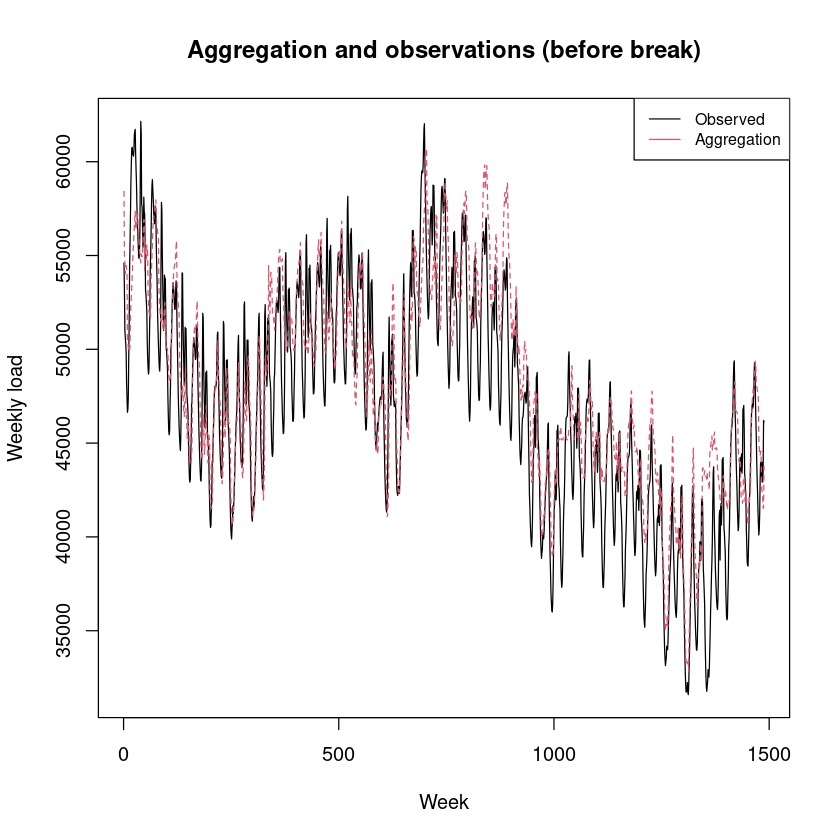

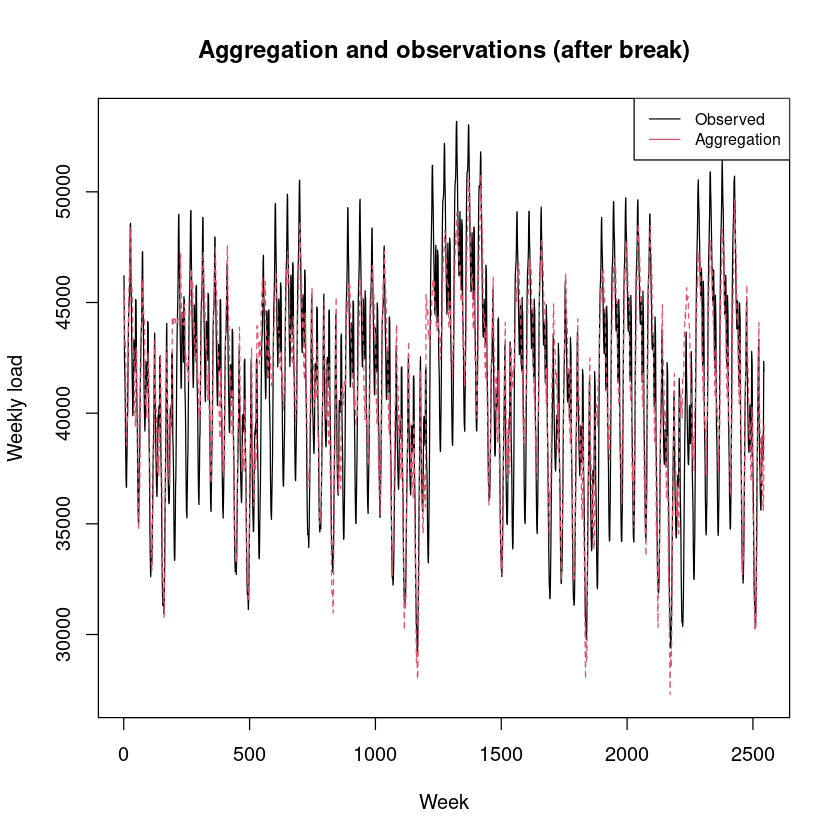

In [39]:
X1_agg <- prediction1
matplot(cbind(Y1, X1_agg), type = "l", col = 1:6, ylab = "Weekly load", 
        xlab = "Week", main = "Aggregation and observations (before break)")
legend("topright", legend = c("Observed", "Aggregation"), col = 1:2, lty = 1, cex = 0.8)

X2_agg <- prediction2
matplot(cbind(Y2, X2_agg), type = "l", col = 1:6, ylab = "Weekly load", 
        xlab = "Week", main = "Aggregation and observations (after break)")
legend("topright", legend = c("Observed", "Aggregation"), col = 1:2, lty = 1, cex = 0.8)

In [43]:
# Convert to dataframe
X1_agg <- as.data.frame(X1_agg)
X2_agg <- as.data.frame(X2_agg)
write.csv(X1_agg, file = "data/experts/X1_agg.csv")
write.csv(X2_agg, file = "data/experts/X2_agg.csv")